In [10]:
fps = 10

In [11]:
# load the data
import pickle
import os

file_path = os.path.join('test_data', 'test_read.pkl')

with open(file_path, 'rb') as f:
    data = pickle.load(f)

expected_keys = {'frames', 'start_time', 'end_time', 'num_frames'}

if isinstance(data, dict) and expected_keys.issubset(data.keys()):
    frames = data['frames']
    start_time = data['start_time']
    end_time = data['end_time']
    num_frames = data['num_frames']

    print("Data loaded successfully.")
    print(f"Start time: {start_time}")
    print(f"End time: {end_time}")
    print(f"Number of frames: {num_frames}")
    print(f"Frames shape: {frames.shape}")
else:
    print("Data format mismatch. Expected a dictionary with keys:", expected_keys)


Data loaded successfully.
Start time: 2025-05-22T17:54:39.140562Z
End time: 2025-05-22T17:54:49.166475Z
Number of frames: 120
Frames shape: (120, 3, 4, 512)


In [31]:
# load the data
import pickle
import os
import numpy as np

file_path = 'realtime_frames.pkl'

with open(file_path, 'rb') as f:
    frames = pickle.load(f)

frames = np.array(frames)
print(f"Frames shape: {frames.shape}")


Frames shape: (112, 3, 4, 512)


(120, 512)


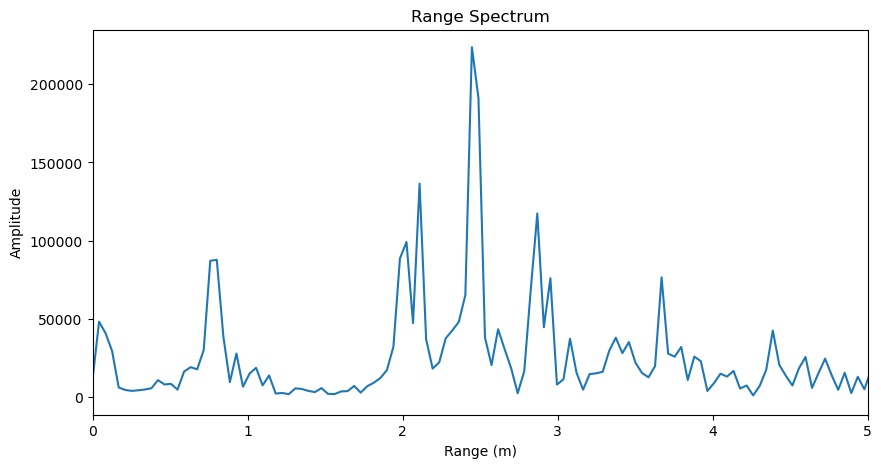

In [12]:
%matplotlib inline
from utils.range_spectrum import compute_range_spectrum_onChirp

# plot range spectrum at frame 0
import matplotlib.pyplot as plt
import numpy as np

# new figure
fig = plt.figure(figsize=(10, 5))
# compute range spectrum
chs = np.squeeze(frames[:, 0, 0, :])
print(chs.shape)
range_meter, range_spectrum = compute_range_spectrum_onChirp(chs[10])
# plot range values
plt.subplot(1, 1, 1)
plt.plot(range_meter, range_spectrum)
plt.title('Range Spectrum')
plt.xlabel('Range (m)')
plt.ylabel('Amplitude')
plt.xlim(0, 5)

plt.show()

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from utils.range_spectrum import compute_range_spectrum_onChirp
from IPython.display import HTML

# ch: shape should be (num_frames, num_samples)
ch = np.squeeze(frames[:, 0, 0, :])  # shape (num_frames, num_samples)
num_frames = ch.shape[0]

fig, ax = plt.subplots(figsize=(10, 5))
line, = ax.plot([], [], lw=2)
ax.set_title('Range Spectrum')
ax.set_xlabel('Range (m)')
ax.set_ylabel('Amplitude')

range_meter, _ = compute_range_spectrum_onChirp(ch[0])
ax.set_xlim(range_meter.min(), range_meter.max())
ax.set_ylim(0, None)  

def init():
    line.set_data([], [])
    return line,

def update(frame_idx):
    range_meter, range_spectrum = compute_range_spectrum_onChirp(ch[frame_idx])
    line.set_data(range_meter, range_spectrum)
    ax.set_ylim(0, np.max(range_spectrum) * 1.1) 
    return line,

ani = FuncAnimation(
    fig, update, frames=num_frames, init_func=init,
    blit=True, interval=1000 / fps
)
plt.close('all')
HTML(ani.to_jshtml())

    

Second FFT shape: (64, 512)
ax shape: (64, 512)
ay shape: (64, 512)


C:\Users\ZJendex\AppData\Local\Temp\ipykernel_38552\2584212665.py:24: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  plt.pcolormesh(y_axis[:, 0:range_limit], x_axis[:, 0:range_limit], second_fft[:, 0:range_limit])


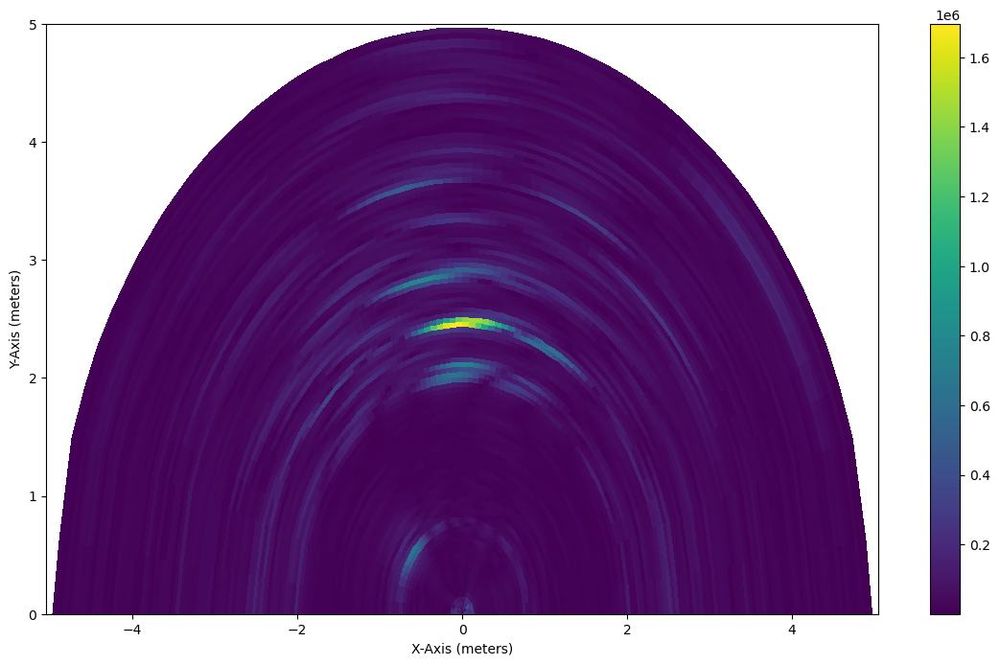

In [14]:
import matplotlib.pyplot as plt
import numpy as np
from utils.range_spectrum import construct_polar_space, compute_rangeFFT_BF
from IPython.display import HTML

num_frames = frames.shape[0]
limit_meter = 5
range_limit = int(limit_meter/0.0422) # 5m

x_axis, y_axis = construct_polar_space()
frame = frames[0]

second_fft = compute_rangeFFT_BF(frame)
second_fft = np.abs(second_fft)

# print shape
print(f"Second FFT shape: {second_fft.shape}")
print(f"ax shape: {x_axis.shape}")
print(f"ay shape: {y_axis.shape}")

# Assuming you have y_axis, x_axis, data, range_limit, file_name, i, and fs defined
# Create the pcolor plot
plt.figure(figsize=(14, 8))
plt.pcolormesh(y_axis[:, 0:range_limit], x_axis[:, 0:range_limit], second_fft[:, 0:range_limit])

# Add colorbar
plt.colorbar()

# Uncomment the next line if you want to set color axis limits
# plt.clim(-15, 15)

# Add labels and title
plt.xlabel('X-Axis (meters)')
plt.ylabel('Y-Axis (meters)')
plt.ylim([0,limit_meter])

# Display the plot
plt.show()




In [15]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.animation import FuncAnimation
from utils.range_spectrum import construct_polar_space, compute_rangeFFT_BF
from IPython.display import HTML

# frames.shape == (num_frames, num_tx, num_rx, num_chirp_samples)
num_frames  = frames.shape[0]
limit_meter = 5
range_limit = int(limit_meter/0.0422) # 5m

x_axis, y_axis = construct_polar_space()

initial_fft = compute_rangeFFT_BF(frames[0])  # shape (…, range_bins)
initial_fft = np.abs(initial_fft)
Z0 = initial_fft[:, :range_limit]

fig, ax = plt.subplots(figsize=(14, 8))
mesh = ax.pcolormesh(
    y_axis[:, :range_limit],
    x_axis[:, :range_limit],
    Z0,
)
cbar = fig.colorbar(mesh)
ax.set_xlabel('X-Axis (meters)')
ax.set_ylabel('Y-Axis (meters)')
ax.set_ylim([0, limit_meter])
# mesh.set_clim(-15, 15)

def init():
    mesh.set_array(Z0.ravel())
    return mesh,

def update(frame_idx):
    fft_data = compute_rangeFFT_BF(frames[frame_idx])
    fft_data = np.abs(fft_data)
    Z = fft_data[:, :range_limit]
    mesh.set_array(Z.ravel())
    return mesh,

anim = FuncAnimation(
    fig,
    update,
    init_func=init,
    frames=num_frames,
    interval=1000 / fps,   
    blit=True
)
plt.close('all')
HTML(anim.to_jshtml())


C:\Users\ZJendex\AppData\Local\Temp\ipykernel_38552\52004509.py:19: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  mesh = ax.pcolormesh(


Second FFT shape: (64, 512)
ax shape: (64, 512)
ay shape: (64, 512)
(32508.907493247636-33348.463166267684j)
-0.0002474587239018552


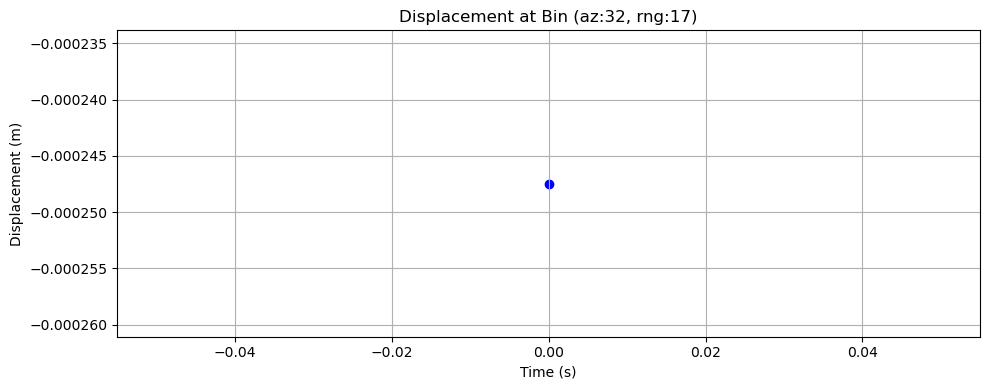

In [16]:
import matplotlib.pyplot as plt
import numpy as np
from utils.range_spectrum import construct_polar_space, compute_rangeFFT_BF, get_phase
from IPython.display import HTML
import matplotlib.animation as animation


az_idx = 32
rng_idx = 17

x_axis, y_axis = construct_polar_space()
frame = frames[100]

second_fft = compute_rangeFFT_BF(frame)

# print shape
print(f"Second FFT shape: {second_fft.shape}")
print(f"ax shape: {x_axis.shape}")
print(f"ay shape: {y_axis.shape}")

displacement = get_phase(second_fft[az_idx, rng_idx])
print(second_fft[az_idx, rng_idx])
print(displacement)


fps = 50
time_axis = np.linspace(0, 1 / fps, 1)
plt.figure(figsize=(10, 4))
plt.scatter(time_axis, displacement, color='blue')
plt.xlabel('Time (s)')
plt.ylabel('Displacement (m)')
plt.title(f'Displacement at Bin (az:{az_idx}, rng:{rng_idx})')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from collections import deque
from utils.range_spectrum import compute_rangeFFT_BF, get_phase
from IPython.display import HTML

print(f"Frames shape: {frames.shape}")
print(f"length of frames: {len(frames)}")

az_idx, rng_idx = 10, 12
fps = 10
window_sec = 3
max_len = int(fps * window_sec)

displacement_history = deque(maxlen=max_len)
time_history = deque(maxlen=max_len)

fig, ax = plt.subplots(figsize=(10, 4))
line, = ax.plot([], [], '-')
ax.set_xlim(0, window_sec)
ax.set_ylim(-0.01, 0.01) 
ax.set_xlabel('Time (s)')
ax.set_ylabel('Displacement (m)')
ax.set_title(f'Displacement at Bin (az:{az_idx}, rng:{rng_idx})')
ax.grid(True)

def update(frame_idx):
    frame = frames[frame_idx]
    fft = compute_rangeFFT_BF(frame)
    disp = get_phase(fft[az_idx, rng_idx])

    t = frame_idx / fps
    time_history.append(t)
    displacement_history.append(disp)

    # 时间重新归零以匹配滑动窗口显示
    t0 = time_history[0]
    time_shifted = [t - t0 for t in time_history]
    line.set_data(time_shifted, displacement_history)
    ax.set_xlim(0, window_sec)
    ax.relim()            # recalculate data limits
    ax.autoscale_view()   # update the view to fit the new data
    return line,

# 动画
ani = animation.FuncAnimation(
    fig,
    update,
    init_func=init,
    frames=len(frames),
    interval=1000 / fps,
    blit=True,
    repeat=False
)

plt.close('all')
HTML(ani.to_jshtml())


Frames shape: (120, 3, 4, 512)
length of frames: 120
